### Figure notebook for plotting Figures 6 and 7

In [25]:
import os
import pandas as pd
import matplotlib as mpl
from matplotlib import pyplot as plt
import numpy as np
import anndata as ad
import scanpy as sc
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.lines import Line2D
import tifffile
import string

mpl.rcParams.update(mpl.rcParamsDefault) #Reset rcParams to default

# Plotting style function (run this before plotting the final figure)
def set_plotting_style():
    plt.style.use('seaborn-paper')
    plt.rc('axes', labelsize=12)
    plt.rc('axes', titlesize=12)
    plt.rc('xtick', labelsize=10)
    plt.rc('ytick', labelsize=10)
    plt.rc('legend', fontsize=10)
    plt.rc('text.latex', preamble=r'\usepackage{sfmath}')
    plt.rc('xtick.major', pad=2)
    plt.rc('ytick.major', pad=2)
    plt.rc('mathtext', fontset='stixsans', sf='sansserif')
    plt.rc('figure', figsize=[10,9])
    plt.rc('svg', fonttype='none')
    
def set_plotting_style_huge():
    plt.style.use('seaborn-paper')
    plt.rc('axes', labelsize=24)
    plt.rc('axes', titlesize=24)
    plt.rc('xtick', labelsize=20)
    plt.rc('ytick', labelsize=20)
    plt.rc('legend', fontsize=20)
    plt.rc('text.latex', preamble=r'\usepackage{sfmath}')
    plt.rc('xtick.major', pad=4)
    plt.rc('ytick.major', pad=4)
    plt.rc('mathtext', fontset='stixsans', sf='sansserif')
    plt.rc('figure', figsize=[10,9])
    plt.rc('svg', fonttype='none')
        
    
# Function to preprocess raw AnnData object

def preprocess_ad(ad, min_counts):
    ad.layers['counts'] = ad.X.copy()
    sc.pp.filter_cells(ad, min_counts=min_counts)
    sc.pp.normalize_total(ad, target_sum=1e4) # Normalize data
    sc.pp.log1p(ad) # Logarithmize the data
    #sc.pp.scale(ad) # Scale each gene to unit variance

In [26]:
# Load data
fileDir = '../../../data/SingleCellData/annotated/'

liver_concat = ad.read_h5ad(fileDir + 'scVI_liver_object.h5ad')
kidney_concat = ad.read_h5ad(fileDir + 'scVI_kidney_object.h5ad')
scanvi_liver = ad.read_h5ad(fileDir + 'scANVI_liver_object.h5ad')
scanvi_kidney = ad.read_h5ad(fileDir + 'scANVI_kidney_object.h5ad')
VizgenLiver = ad.read_h5ad(fileDir + 'MERFISH_liver_object.h5ad')
VizgenKidney = ad.read_h5ad(fileDir + 'MERFISH_kidney_object.h5ad')

# Load DAPI mosaic images
imDir = '../../../data/Images'

dapiMosaicLowRes = []
dapiMosaicLowRes.append(tifffile.TiffFile(os.path.join(imDir, 'liver_DAPI_mosaic.tiff')).asarray()) #Liver DAPI
dapiMosaicLowRes.append(tifffile.TiffFile(os.path.join(imDir, 'kidney_DAPI_mosaic.tiff')).asarray()) #Kidney DAPI

# Rotate coordinates for liver DAPI mosaic to make the aspect ratio nicer
#dapiMosaicLowRes[0] = dapiMosaicLowRes[0].transpose()

# Rotate coordinates for liver to make the aspect ratio nicer
scanvi_liver.obsm['spatial'] = scanvi_liver.obsm['spatial'][:,[1,0]].copy()
VizgenLiver.obsm['spatial'] = VizgenLiver.obsm['spatial'][:,[1,0]].copy()

# Remap cell type labels to coarse groups
liver_relabel_map = {'B cell': 'immune cell',
                    'NK cell': 'immune cell',
                    'periportal endothelial cell': 'periportal endothelial cell',
                    'pericentral endothelial cell': 'pericentral endothelial cell',
                    'other endothelial cell': 'other endothelial cell',
                    'myeloid leukocyte': 'immune cell',
                    'plasmacytoid dendritic cell': 'immune cell',
                    'Kupffer cell': 'Kupffer cell',
                    'hepatic stellate cell': 'hepatic stellate cell',
                    'other hepatocyte': 'other hepatocyte',
                    'periportal hepatocyte': 'periportal hepatocyte',
                    'pericentral hepatocyte': 'pericentral hepatocyte'}
kidney_relabel_map = {'macrophage': 'immune cell',
                     'lymphocyte': 'immune cell',
                     'glomerular capillary endothelial cell': 'endothelial cell',
                     'kidney blood vessel cell': 'endothelial cell',
                     'plasma cell': 'immune cell',
                     'epithelial cell of proximal tubule': 'epithelial cell of proximal tubule',
                     'kidney loop of Henle epithelial cell': 'kidney loop of Henle epithelial cell',
                     'kidney distal convoluted tubule epithelial cell': 'kidney distal convoluted tubule epithelial cell',
                     'kidney collecting duct epithelial cell': 'kidney collecting duct epithelial cell',
                     'pericyte': 'pericyte',
                     'podocyte': 'podocyte',
                     'fibroblast': 'fibroblast'}

liver_concat.obs['predicted_cell_type'] = liver_concat.obs['predicted_cell_type'].map(liver_relabel_map)
scanvi_liver.obs['predicted_cell_type'] = scanvi_liver.obs['predicted_cell_type'].map(liver_relabel_map)
kidney_concat.obs['predicted_cell_type'] = kidney_concat.obs['predicted_cell_type'].map(kidney_relabel_map)
scanvi_kidney.obs['predicted_cell_type'] = scanvi_kidney.obs['predicted_cell_type'].map(kidney_relabel_map)

# Create abbreviated cell type labels
liver_abbrev_map = {'immune cell': 'IC',
                   'other endothelial cell': 'o-EC',
                   'Kupffer cell': 'KC',
                   'hepatic stellate cell': 'HSC',
                   'other hepatocyte': 'o-hep',
                   'periportal hepatocyte': 'PP-hep',
                   'pericentral hepatocyte': 'PC-hep',
                   'periportal endothelial cell': 'PP-EC',
                   'pericentral endothelial cell': 'PC-EC'}
kidney_abbrev_map = {'epithelial cell of proximal tubule':'EC-PT',
                    'immune cell': 'IC',
                    'pericyte':'per',
                    'kidney loop of Henle epithelial cell':'KLH-EC',
                    'kidney collecting duct epithelial cell':'KCD-EC',
                    'kidney distal convoluted tubule epithelial cell':'KDCT-EC',
                    'endothelial cell': 'EC',
                    'podocyte':'pod',
                    'fibroblast':'fib'}

liver_concat.obs['predicted_cell_type_abv'] = liver_concat.obs['predicted_cell_type'].map(liver_abbrev_map)
scanvi_liver.obs['predicted_cell_type_abv'] = scanvi_liver.obs['predicted_cell_type'].map(liver_abbrev_map)
VizgenLiver.obs['tentative_annot_abv'] = VizgenLiver.obs['tentative_annot'].map(liver_abbrev_map)
kidney_concat.obs['predicted_cell_type_abv'] = kidney_concat.obs['predicted_cell_type'].map(kidney_abbrev_map)
scanvi_kidney.obs['predicted_cell_type_abv'] = scanvi_kidney.obs['predicted_cell_type'].map(kidney_abbrev_map)
VizgenKidney.obs['tentative_annot_abv'] = VizgenKidney.obs['tentative_annot'].map(kidney_abbrev_map)

print('Results loaded.')

Results loaded.


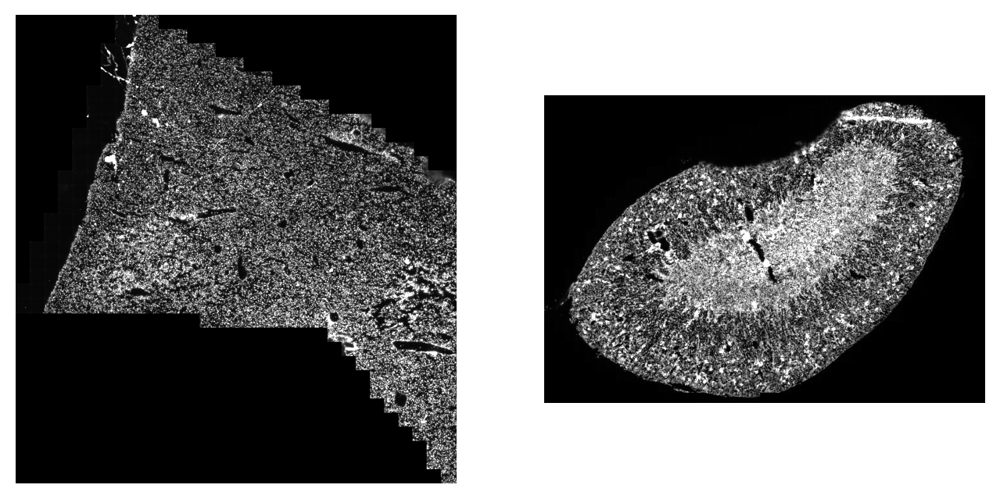

In [27]:
# Plot DAPI mosaics

fig, axes = plt.subplots(1,2, figsize=(8,4))

ax = axes[0]
ax.imshow(dapiMosaicLowRes[0], cmap='gray', vmax=10000)
ax.axis('off')

ax = axes[1]
ax.imshow(dapiMosaicLowRes[1], cmap='gray', vmax=20000)
ax.axis('off')

plt.show()

<Figure size 640x480 with 0 Axes>

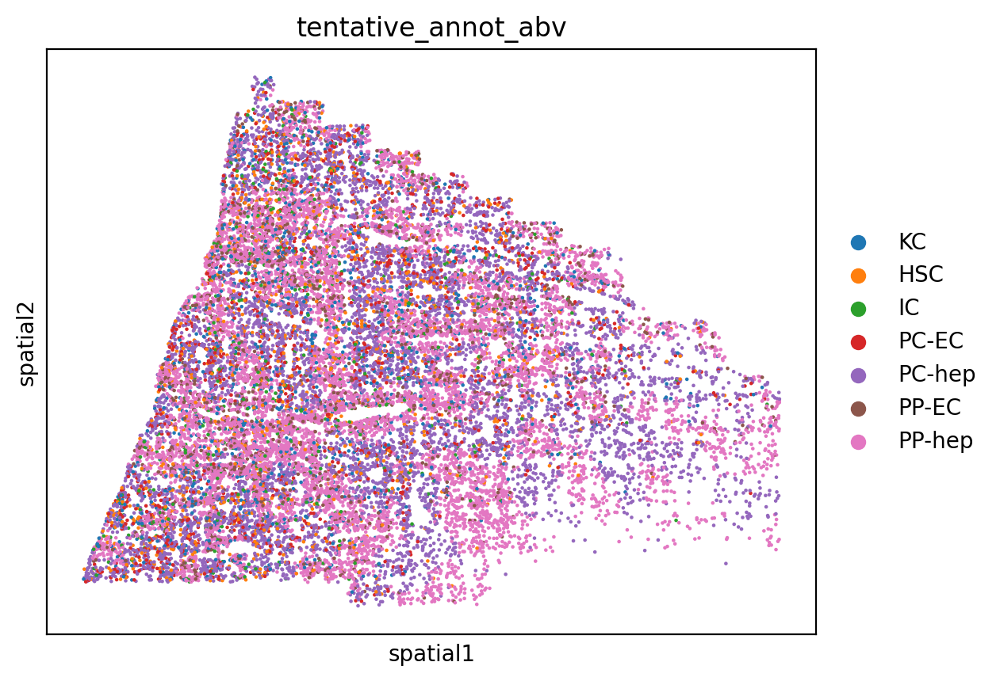

<Figure size 640x480 with 0 Axes>

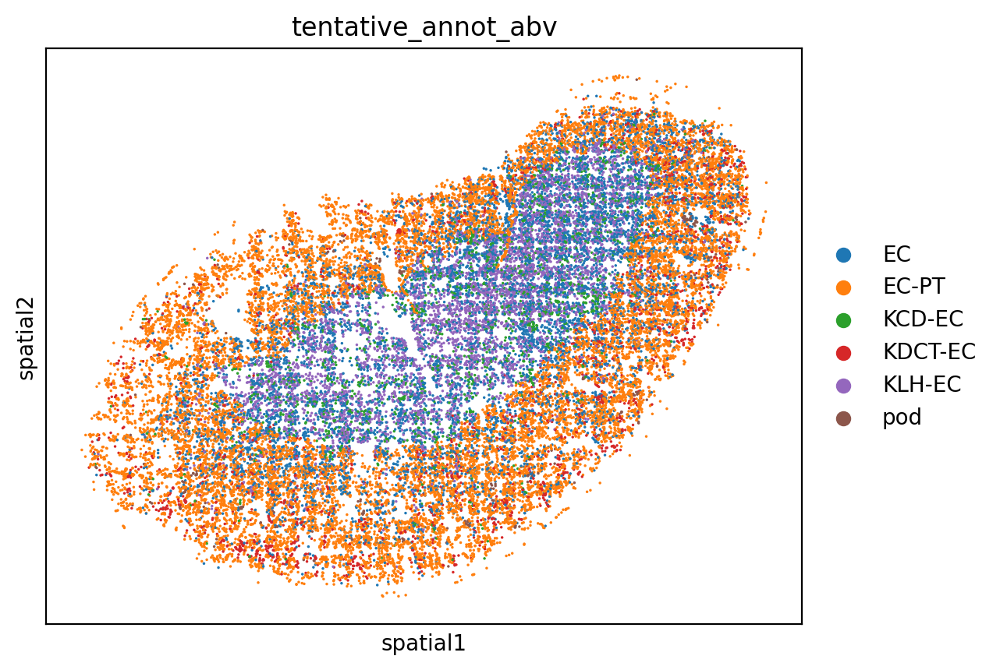

In [28]:
# Plot Vizgen spatial plots
plt.figure()
sc.pl.spatial(VizgenLiver, color='tentative_annot_abv', spot_size=30)
plt.show()

plt.figure()
sc.pl.spatial(VizgenKidney, color='tentative_annot_abv', spot_size=30)
plt.show()

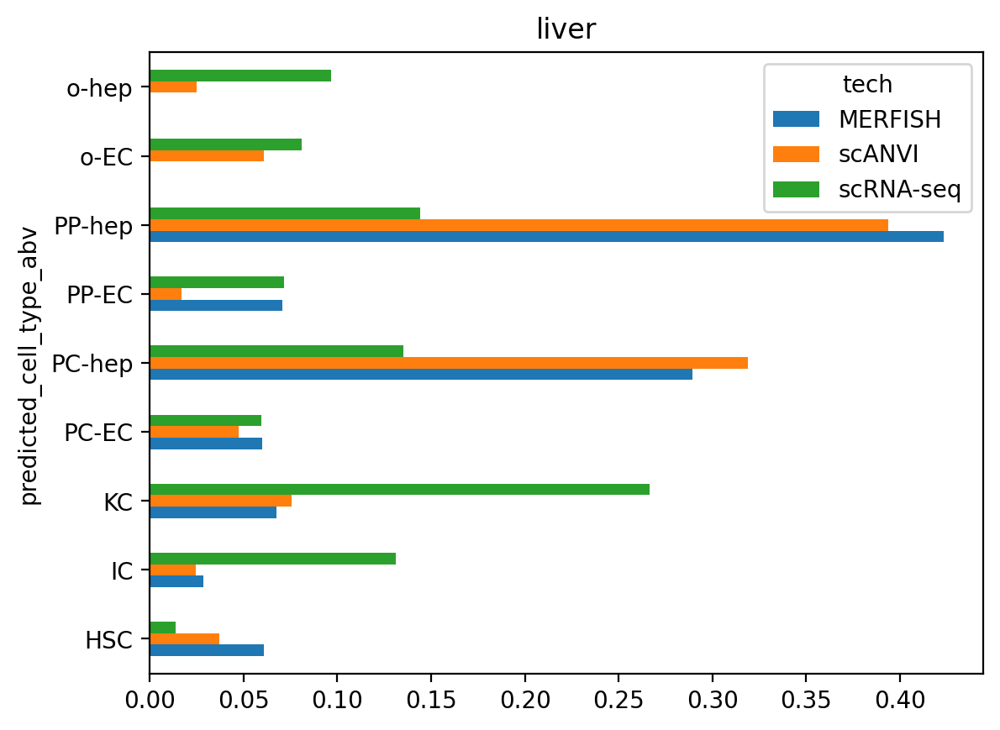

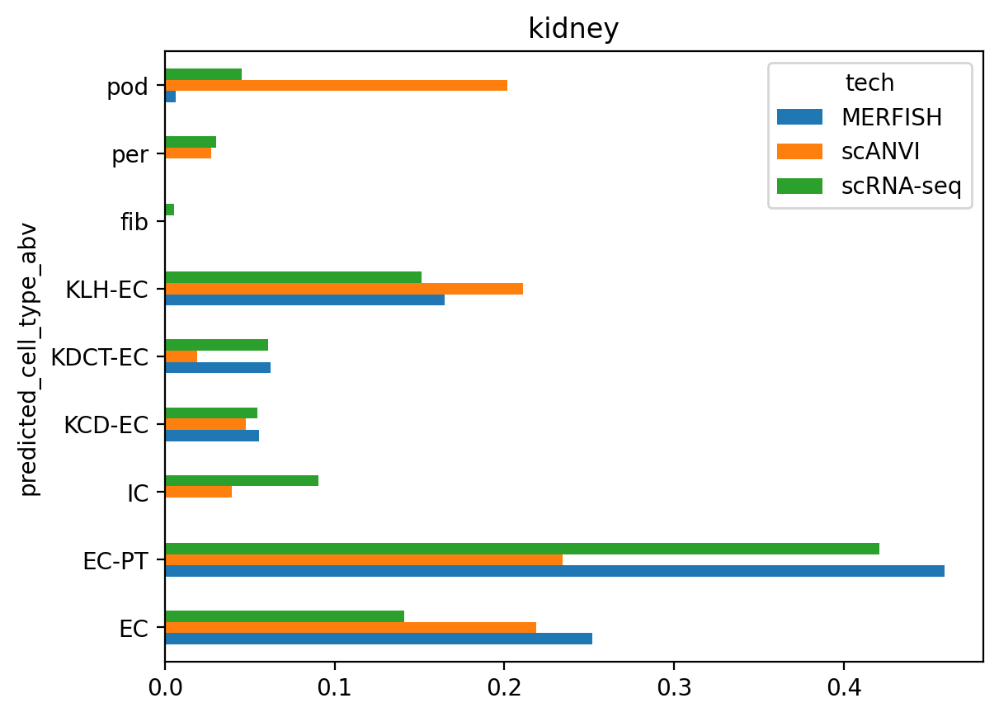

In [29]:
# Cell type frequencies
# Now plot the fraction of cell types for each technology
# Liver

VizgenLiver.obs['predicted_cell_type_abv'] = VizgenLiver.obs['tentative_annot_abv'].copy()
VizgenLiver.obs['tech'] = 'MERFISH'
liver_concat.obs['tech'] = liver_concat.obs['tech'].replace('MERFISH','scANVI')
liver_celltypes = pd.concat([liver_concat.obs.loc[:,['tech','predicted_cell_type_abv']],
                            VizgenLiver.obs.loc[:,['tech','predicted_cell_type_abv']]])

# Regroup endothelial subgroups to master group

liver_celltype_counts = liver_celltypes.groupby(by=['tech','predicted_cell_type_abv']).size().unstack().transpose()
liver_celltype_frac = liver_celltype_counts / liver_celltype_counts.sum(axis=0)



liver_celltype_frac.plot.barh(title='liver')
plt.show()

# Kidney
VizgenKidney.obs['predicted_cell_type_abv'] = VizgenKidney.obs['tentative_annot_abv'].copy()
VizgenKidney.obs['tech'] = 'MERFISH'
kidney_concat.obs['tech'] = kidney_concat.obs['tech'].replace('MERFISH','scANVI')
kidney_celltypes = pd.concat([kidney_concat.obs.loc[:,['tech','predicted_cell_type_abv']],
                            VizgenKidney.obs.loc[:,['tech','predicted_cell_type_abv']]])

kidney_celltype_counts = kidney_celltypes.groupby(by=['tech','predicted_cell_type_abv']).size().unstack().transpose()
kidney_celltype_frac = kidney_celltype_counts / kidney_celltype_counts.sum(axis=0)

kidney_celltype_frac.plot.barh(title='kidney')
plt.show()

/data01/jonathan.liu/miniconda3/envs/jupyter/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'tech' as categorical
/data01/jonathan.liu/miniconda3/envs/jupyter/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predicted_cell_type' as categorical
/data01/jonathan.liu/miniconda3/envs/jupyter/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorde

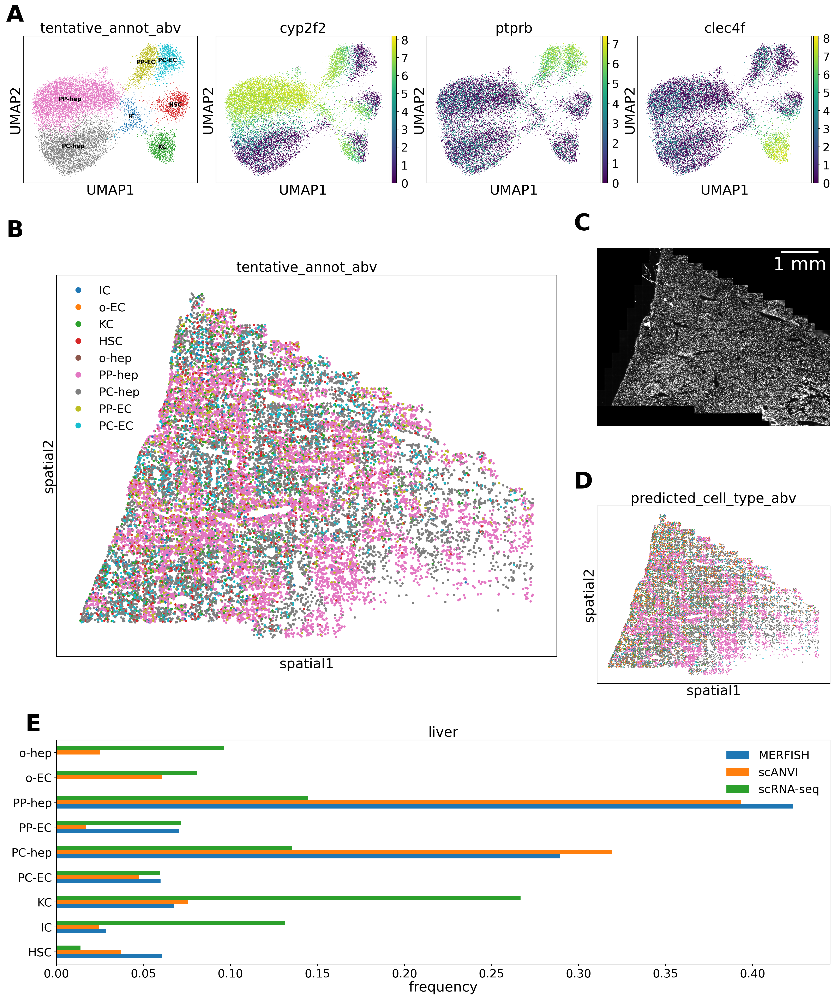

In [30]:
# Plot the liver only (new layout)
sc.set_figure_params(vector_friendly=True, dpi=300, dpi_save=2000)
mpl.rcParams.update(mpl.rcParamsDefault) #Reset rcParams to default
set_plotting_style_huge()

fig6 = plt.figure(figsize=(20,24), constrained_layout=True) # Create figure
subfigs = fig6.subfigures(2,1, height_ratios=[0.25, 1]) # Create subfigures
axes0 = subfigs[0].subplots(1,4) # Axes for top subfigure
axes1 = subfigs[1].subplots(3,3) # Axes for bottom subfigure

# remove the underlying axes for the spatial panel and the last panel
gs = axes1[0,0].get_gridspec() #Get gridspecs
for i in [0,1]:
    for j in [0,1]:
        axes1[i,j].remove()
for i in [2]:
    for j in [0,1,2]:
        axes1[i,j].remove()

axbig1 = subfigs[1].add_subplot(gs[0:2, 0:2])
axbig2 = subfigs[1].add_subplot(gs[2, 0:3])


# Use the same colormap for the cell types between methods
colormap_liver = {list(liver_abbrev_map.values())[x]:
                 mpl.cm.get_cmap('tab10',len(list(liver_abbrev_map.values())))(x) for x in
                 range(len(list(liver_abbrev_map.values())))}


# Panel A: Vizgen liver UMAP
ax = axes0[0]
sc.pl.umap(VizgenLiver, color='tentative_annot_abv', ax=ax, show=False, legend_loc='on data',
          palette=colormap_liver, frameon=True, size=20)

ax = axes0[1]
sc.pl.umap(VizgenLiver, color='cyp2f2', ax=ax, show=False, legend_loc=None,
          frameon=True, size=20)

ax = axes0[2]
sc.pl.umap(VizgenLiver, color='ptprb', ax=ax, show=False, legend_loc=None,
          frameon=True, size=20)

ax = axes0[3]
sc.pl.umap(VizgenLiver, color='clec4f', ax=ax, show=False, legend_loc=None,
          frameon=True, size=20)

# Panel B: Vizgen liver spatial plot
ax = axbig1
liver_legend = [Line2D([0], [0], marker='o', color='w', label=list(colormap_liver.keys())[x],
                        markerfacecolor=list(colormap_liver.values())[x], markersize=10)
                for x in range(len(colormap_liver))]
sc.pl.spatial(VizgenLiver, color='tentative_annot_abv', spot_size=30, ax=ax, show=False,
             palette=colormap_liver)
ax.legend(handles=liver_legend, loc='upper left', frameon=False)

# Panel C: DAPI spatial plot
size_of_one_pixel = 0.1080000004119873 # Size of one pixel
dscale = 20 # Downsampling factor used in generating DAPI mosaic
xMin = 0
xMax = 2200
yMin = 0
yMax = dapiMosaicLowRes[0].shape[1]
ax = axes1[0,2]
ax.imshow(dapiMosaicLowRes[0][xMin:xMax, yMin:yMax], cmap='gray', vmax=10000)
ax.axis('off')
scalebar = ScaleBar(size_of_one_pixel*dscale/1000, "mm", color='w', box_color='k', box_alpha=0, location='upper right', 
                   font_properties={'size':32})
ax.add_artist(scalebar)

# Panel F: scANVI liver spatial plot
ax = axes1[1,2]
sc.pl.spatial(scanvi_liver, color="predicted_cell_type_abv", spot_size=30, ax=ax, show=False,
             palette=colormap_liver, legend_loc=None)

# Panel G: cell type composition for liver
ax = axbig2
liver_celltype_frac.plot.barh(title='liver', ax=ax)
ax.set_ylabel('')
ax.set_xlabel('frequency')
ax.legend(frameon=False)

# Label subpanels
axes_label = [axes0[0], axbig1, axes1[0,2], axes1[1,2], axbig2]
for n, ax in enumerate(axes_label):
    if n == 4 or n == 7:
        ax.text(-0.04, 1.04, string.ascii_uppercase[n], transform=ax.transAxes, 
                size=40, weight='bold')
    else:
        ax.text(-0.1, 1.1, string.ascii_uppercase[n], transform=ax.transAxes, 
                size=40, weight='bold')

plt.show()

/data01/jonathan.liu/miniconda3/envs/jupyter/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'tech' as categorical
/data01/jonathan.liu/miniconda3/envs/jupyter/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predicted_cell_type' as categorical
/data01/jonathan.liu/miniconda3/envs/jupyter/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorde

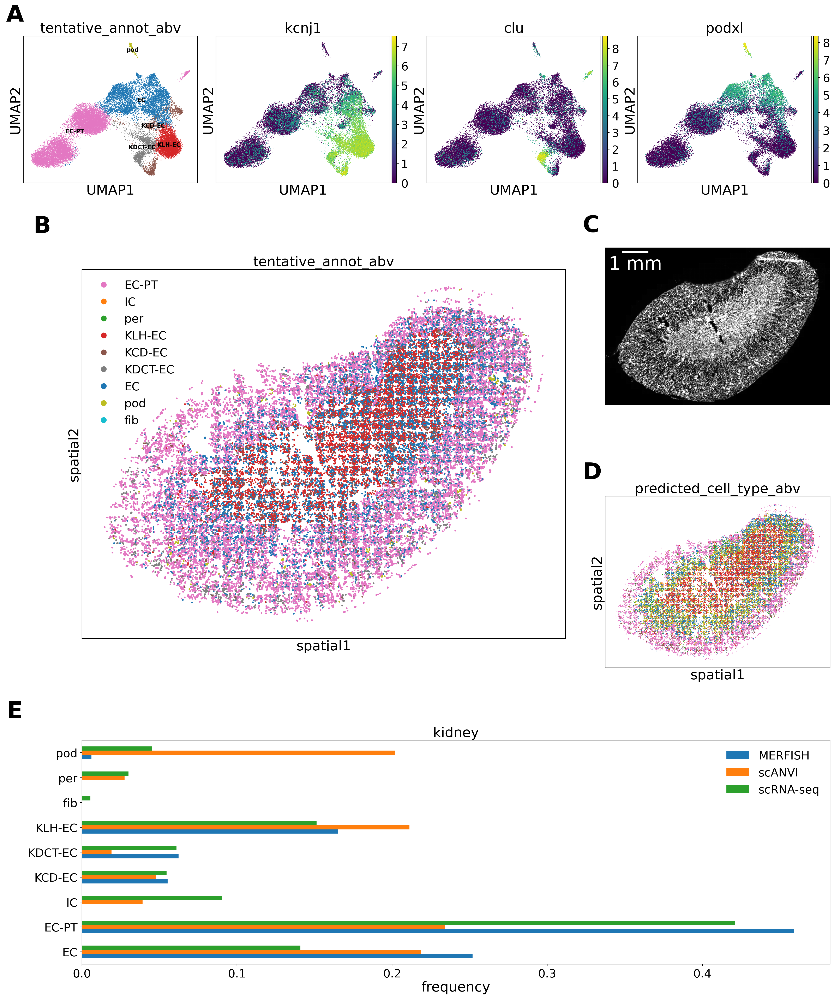

In [31]:
# Plot the kidney only (new layout)

sc.set_figure_params(vector_friendly=True, dpi=300, dpi_save=2000)
mpl.rcParams.update(mpl.rcParamsDefault) #Reset rcParams to default
set_plotting_style_huge()

fig7 = plt.figure(figsize=(20,24), constrained_layout=True) # Create figure
subfigs = fig7.subfigures(2,1, height_ratios=[0.25, 1]) # Create subfigures
axes0 = subfigs[0].subplots(1,4) # Axes for top subfigure
axes1 = subfigs[1].subplots(3,3) # Axes for bottom subfigure

# remove the underlying axes for the spatial panel and the last panel
gs = axes1[0,0].get_gridspec() #Get gridspecs
for i in [0,1]:
    for j in [0,1]:
        axes1[i,j].remove()
for i in [2]:
    for j in [0,1,2]:
        axes1[i,j].remove()

axbig1 = subfigs[1].add_subplot(gs[0:2, 0:2])
axbig2 = subfigs[1].add_subplot(gs[2, 0:3])


# Use the same colormap for the cell types between methods
colormap_kidney = {list(kidney_abbrev_map.values())[x]:
                 mpl.cm.get_cmap('tab10',len(list(kidney_abbrev_map.values())))(x) for x in
                 range(len(list(kidney_abbrev_map.values())))}

# Swap some colors
colormap_kidney['EC-PT'] = 'tab:pink'
colormap_kidney['EC'] = 'tab:blue'
colormap_kidney['KDCT-EC'] = 'tab:gray'


# Panel A: Vizgen kidney UMAP
ax = axes0[0]
sc.pl.umap(VizgenKidney, color='tentative_annot_abv', ax=ax, show=False, legend_loc='on data',
          palette=colormap_kidney, size=20)

ax = axes0[1]
sc.pl.umap(VizgenKidney, color='kcnj1', ax=ax, show=False, legend_loc=None,
          frameon=True, size=20)

ax = axes0[2]
sc.pl.umap(VizgenKidney, color='clu', ax=ax, show=False, legend_loc=None,
          frameon=True, size=20)

ax = axes0[3]
sc.pl.umap(VizgenKidney, color='podxl', ax=ax, show=False, legend_loc=None,
          frameon=True, size=20)

# Panel B: Vizgen kidney spatial plot
ax = axbig1
kidney_legend = [Line2D([0], [0], marker='o', color='w', label=list(colormap_kidney.keys())[x],
                        markerfacecolor=list(colormap_kidney.values())[x], markersize=10)
                for x in range(len(colormap_kidney))]
sc.pl.spatial(VizgenKidney, color='tentative_annot_abv', spot_size=30, ax=ax, show=False,
             palette=colormap_kidney, legend_loc=None)
ax.legend(handles=kidney_legend, loc='upper left', frameon=False)

# Panel C: DAPI spatial plot
size_of_one_pixel = 0.1080000004119873 # Size of one pixel
xMin = 0
xMax = dapiMosaicLowRes[1].shape[0]
yMin = 0
yMax = dapiMosaicLowRes[1].shape[1]
ax = axes1[0,2]
ax.imshow(dapiMosaicLowRes[1][xMin:xMax, yMin:yMax], cmap='gray', vmax=20000)
ax.axis('off')
scalebar = ScaleBar(size_of_one_pixel*dscale/1000, "mm", color='w', box_color='k', box_alpha=0, location='upper left', 
                   font_properties={'size':32})
ax.add_artist(scalebar)

# Panel F: scANVI kidney spatial plot
ax = axes1[1,2]
sc.pl.spatial(scanvi_kidney, color="predicted_cell_type_abv", spot_size=30, ax=ax, show=False,
             palette=colormap_kidney, legend_loc=None)

# Panel G: cell type composition for kidney
ax = axbig2
kidney_celltype_frac.plot.barh(title='kidney', ax=ax)
ax.set_ylabel('')
ax.set_xlabel('frequency')
ax.legend(frameon=False)

# Label subpanels
axes_label = [axes0[0], axbig1, axes1[0,2], axes1[1,2], axbig2]
for n, ax in enumerate(axes_label):
    if n == 6:
        ax.text(-0.04, 1.04, string.ascii_uppercase[n], transform=ax.transAxes, 
                size=40, weight='bold')
    else:
        ax.text(-0.1, 1.1, string.ascii_uppercase[n], transform=ax.transAxes, 
                size=40, weight='bold')

plt.show()

In [32]:
# Export figures
fig6.savefig('../../figures/Fig6_liver_analysis.svg', transparent=True)
fig6.savefig('../../figures/Fig6_liver_analysis.png', transparent=True)

fig7.savefig('../../figures/Fig7_kidney_analysis.svg', transparent=True)
fig7.savefig('../../figures/Fig7_kidney_analysis.png', transparent=True)

print('Figures saved.')

Figures saved.
